# Analysis of NYC public schools results in ELA and math grades 3-8.

<span style="color: red;">**If kernel can't connect to server again run command:**
*netsh winsock reset*<span>

#### Data:
Data New York City grades 3-8 New York State English Language Arts and Math State Tests results 2013-2023: https://infohub.nyced.org/reports/academics/test-results

#### Imports: modules

In [1]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from shapely.geometry import Point

pd.set_option('display.float_format', '{:.3f}'.format)

#### Read data

In [2]:
basePath = r"D:\.shortcut-targets-by-id\1c4wCBVjOg0tiW0xxI4zE2Wjj1FnzKBJL\Kids\NY school"
fileName_math = "school-math-results-2013-2023-(public).xlsx"
mathPath = os.path.join(basePath,fileName_math)
print(mathPath)
sheetName_math = "All"
mathResultsDF = pd.read_excel(mathPath, sheetName_math)

D:\.shortcut-targets-by-id\1c4wCBVjOg0tiW0xxI4zE2Wjj1FnzKBJL\Kids\NY school\school-math-results-2013-2023-(public).xlsx


In [3]:
mathResultsDF.head()

,DBN,School Name,Grade,Year,Category,Number Tested,Mean Scale Score,# Level 1,% Level 1,# Level 2,% Level 2,# Level 3,% Level 3,# Level 4,% Level 4,# Level 3+4,% Level 3+4
0,01M015,P.S. 015 ROBERTO CLEMENTE,3,2023,All Students,27,447,6,22.222,9,33.333,7,25.926,5,18.519,12,44.444
1,01M015,P.S. 015 ROBERTO CLEMENTE,4,2023,All Students,23,444.870,7,30.435,3,13.043,12,52.174,1,4.348,13,56.522
2,01M015,P.S. 015 ROBERTO CLEMENTE,5,2023,All Students,30,431.867,14,46.667,11,36.667,5,16.667,0,0,5,16.667
3,01M015,P.S. 015 ROBERTO CLEMENTE,6,2023,All Students,1,s,s,s,s,s,s,s,s,s,s,s
4,01M015,P.S. 015 ROBERTO CLEMENTE,All Grades,2023,All Students,81,s,s,s,s,s,s,s,s,s,s,s


In [7]:
mathResultsDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41918 entries, 0 to 41917
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   DBN               41918 non-null  object
 1   School Name       41918 non-null  object
 2   Grade             41918 non-null  object
 3   Year              41918 non-null  int64 
 4   Category          41918 non-null  object
 5   Number Tested     41918 non-null  int64 
 6   Mean Scale Score  41918 non-null  object
 7   # Level 1         41918 non-null  object
 8   % Level 1         41918 non-null  object
 9   # Level 2         41918 non-null  object
 10  % Level 2         41918 non-null  object
 11  # Level 3         41918 non-null  object
 12  % Level 3         41918 non-null  object
 13  # Level 4         41918 non-null  object
 14  % Level 4         41918 non-null  object
 15  # Level 3+4       41918 non-null  object
 16  % Level 3+4       41918 non-null  object
dtypes: int64(2),

In [47]:
# mathResultsDF.info() showed that most of the columns are objects instead of numbers and needed to be converted
mathResultsDF_colToConvert = ['Mean Scale Score',
 'Grade',                             
 '# Level 1',
 '% Level 1',
 '# Level 2',
 '% Level 2',
 '# Level 3',
 '% Level 3',
 '# Level 4',
 '% Level 4',
 '# Level 3+4',
 '% Level 3+4']
mathResultsDF[mathResultsDF_colToConvert] = mathResultsDF[mathResultsDF_colToConvert].apply(pd.to_numeric, errors = 'coerce')
mathResultsDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41918 entries, 0 to 41917
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DBN               41918 non-null  object 
 1   School Name       41918 non-null  object 
 2   Grade             32173 non-null  float64
 3   Year              41918 non-null  int64  
 4   Category          41918 non-null  object 
 5   Number Tested     41918 non-null  int64  
 6   Mean Scale Score  41559 non-null  float64
 7   # Level 1         41559 non-null  float64
 8   % Level 1         41559 non-null  float64
 9   # Level 2         41559 non-null  float64
 10  % Level 2         41559 non-null  float64
 11  # Level 3         41559 non-null  float64
 12  % Level 3         41559 non-null  float64
 13  # Level 4         41559 non-null  float64
 14  % Level 4         41559 non-null  float64
 15  # Level 3+4       41559 non-null  float64
 16  % Level 3+4       41559 non-null  float6

#### Definitions of Performance Levels for the 2023 Grades 3-8 English Language Arts and Mathematics Tests  

**NYS Level 1**: Students performing at this level are below proficient in standards for their grade. They may demonstrate limited knowledge, skills, and practices embodied by the Learning Standards that are considered insufficient for the expectations at this grade. 

**NYS Level 2**: Students performing at this level are partially proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered partial but insufficient for the expectations at this grade. Students performing at Level 2 are considered on track to meet current New York high school graduation requirements but are not yet proficient in Learning Standards at this grade. 

**NYS Level 3**: Students performing at this level are proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered sufficient for the expectations at this grade.  

**NYS Level 4**: Students performing at this level excel in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered more than sufficient for the expectations at this grade.  

*Source: NYSED, 2023, https://www.p12.nysed.gov/irs/ela-math/2023/ela-math-score-ranges-performance-levels-2023.pdf*

In [9]:
list(mathResultsDF.columns)

['DBN',
 'School Name',
 'Grade',
 'Year',
 'Category',
 'Number Tested',
 'Mean Scale Score',
 '# Level 1',
 '% Level 1',
 '# Level 2',
 '% Level 2',
 '# Level 3',
 '% Level 3',
 '# Level 4',
 '% Level 4',
 '# Level 3+4',
 '% Level 3+4']

In [10]:
uniqueValuesYears_math = mathResultsDF['Year'].unique()
uniqueValuesYears_math

array([2023, 2022, 2019, 2018, 2017, 2016, 2015, 2014, 2013], dtype=int64)

In [11]:
uniqueValuesGrades_math = mathResultsDF['Grade'].unique()
uniqueValuesGrades_math

array([ 3.,  4.,  5.,  6., nan,  7.,  8.])

In [12]:
uniqueValuesCategory_math = mathResultsDF['Category'].unique()
uniqueValuesCategory_math

array(['All Students'], dtype=object)

## Analysis

See proportion of schools with share of students scored level 4 >80% by years

See share of schools in each districts by year

In [10]:
indDistr_01 = mathResultsDF['DBN'].str.startswith('01')
indAllSt = mathResultsDF['Grade']== 'All Grades'


disctrictShareDF = mathResultsDF[indDistr_01&indAllSt]
disctrictShareDF.groupby(['Year'])['# Level 4'] .sum()
#len(disctrictShareDF.index)
#disctrictShareDF.head()

Series([], Name: # Level 4, dtype: float64)

#### Calculate share of students with results in Level 4 in all schools by year

In [11]:
# Group by 'Year' and calculate the sum for '# Level 4' and 'Number Tested'
grouped_df = mathResultsDF.groupby('Year')[['# Level 4', 'Number Tested']].sum()

# Calculate the share of '# Level 4' values in 'Number Tested'
grouped_df['Share of # Level 4'] = grouped_df['# Level 4'] / grouped_df['Number Tested']

# Print the result
print(grouped_df['Share of # Level 4'])


Year
2013   0.120
2014   0.151
2015   0.162
2016   0.183
2017   0.186
2018   0.222
2019   0.247
2022   0.197
2023   0.194
Name: Share of # Level 4, dtype: float64


#### Math test results, the whole city

In [12]:
columns_df = mathResultsDF.groupby('Year')[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
print(columns_df)

      # Level 1  # Level 2  # Level 3  # Level 4
Year                                            
2013 260785.000 265230.000 150559.000  92907.000
2014 234809.000 243993.000 158758.000 113749.000
2015 231929.000 237079.000 154596.000 120842.000
2016 227150.000 233337.000 147127.000 136413.000
2017 233413.000 219239.000 153674.000 138435.000
2018 225107.000 184699.000 160900.000 163694.000
2019 207441.000 179147.000 162347.000 180906.000
2022 211591.000 136706.000 110012.000 114269.000
2023 139242.000 136457.000 178279.000 111758.000


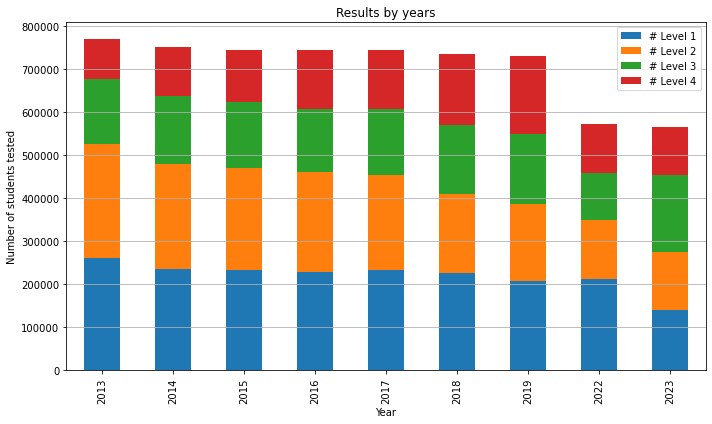

In [13]:
# Create a stacked bar chart
columns_df.plot(kind='bar', stacked=True, figsize=(10,6))

plt.title('Results by years')  # Set the title
plt.xlabel('Year')  # X-axis label
plt.ylabel('Number of students tested')  # Y-axis label
plt.grid(axis='y')

plt.tight_layout()
plt.show() # Display the plot

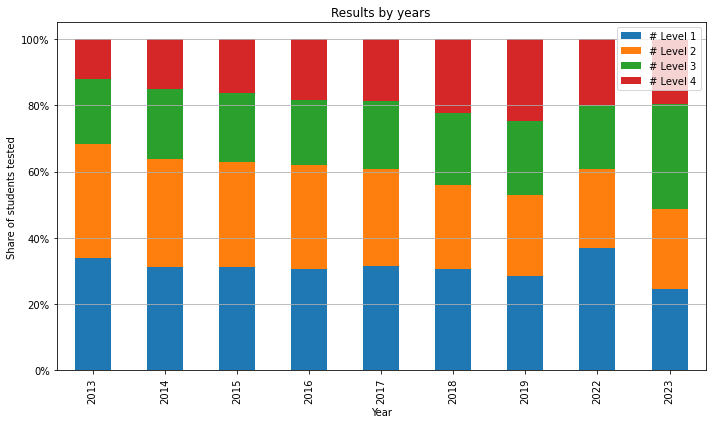

In [14]:
#Create a normalized bar chart
# 1. Normalize the dataframe rows to sum to 1
normalized_df = columns_df.div(columns_df.sum(axis=1), axis=0)

# 2. Plot the normalized dataframe
normalized_df.plot(kind='bar', stacked=True, figsize=(10,6))

plt.title('Results by years')  # Set the title
plt.xlabel('Year')  # X-axis label
plt.ylabel('Share of students tested')  # Y-axis label
plt.grid(axis='y')
plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0], ['0%', '20%', '40%', '60%', '80%', '100%'])  # Adjust y-ticks to percentage

plt.tight_layout()
plt.show()

#### Middle Schools math test results by school district

In [15]:
dist01_MS_mathDF = mathResultsDF[(mathResultsDF['DBN'].str.startswith('01')) & (mathResultsDF['Grade'] >= 6)&(mathResultsDF['Grade'] <= 8)]
dist01_MS_mathDF.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 233 entries, 3 to 843
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DBN               233 non-null    object 
 1   School Name       233 non-null    object 
 2   Grade             233 non-null    float64
 3   Year              233 non-null    int64  
 4   Category          233 non-null    object 
 5   Number Tested     233 non-null    int64  
 6   Mean Scale Score  229 non-null    float64
 7   # Level 1         229 non-null    float64
 8   % Level 1         229 non-null    float64
 9   # Level 2         229 non-null    float64
 10  % Level 2         229 non-null    float64
 11  # Level 3         229 non-null    float64
 12  % Level 3         229 non-null    float64
 13  # Level 4         229 non-null    float64
 14  % Level 4         229 non-null    float64
 15  # Level 3+4       229 non-null    float64
 16  % Level 3+4       229 non-null    float64
dt

In [16]:
dist01_MS_grouped = dist01_MS_mathDF.groupby('Year')[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
dist01_MS_grouped

,# Level 1,# Level 2,# Level 3,# Level 4
Year,,,,
2013,516.000,617.000,388.000,472.000
2014,455.000,556.000,388.000,380.000
2015,384.000,539.000,336.000,373.000
2016,383.000,560.000,303.000,453.000
2017,524.000,516.000,309.000,437.000
2018,526.000,384.000,366.000,502.000
2019,467.000,354.000,337.000,568.000
2022,396.000,329.000,236.000,370.000
2023,278.000,263.000,373.000,385.000


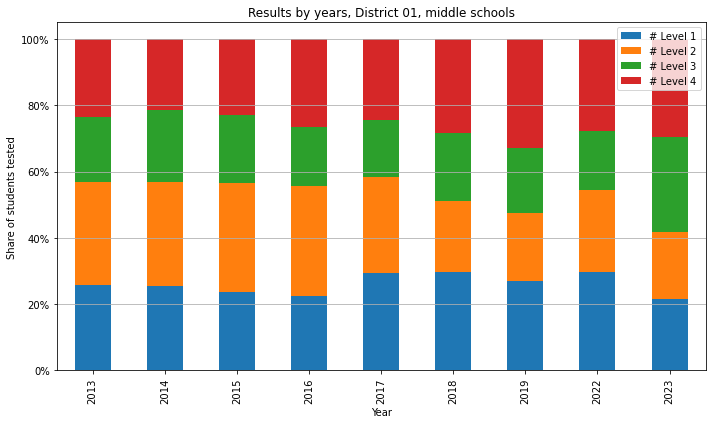

In [17]:
#Create a normalized bar chart
# 1. Normalize the dataframe rows to sum to 1
normalized_df = dist01_MS_grouped.div(dist01_MS_grouped.sum(axis=1), axis=0)

# 2. Plot the normalized dataframe
normalized_df.plot(kind='bar', stacked=True, figsize=(10,6))

plt.title('Results by years, District 01, middle schools')  # Set the title
plt.xlabel('Year')  # X-axis label
plt.ylabel('Share of students tested')  # Y-axis label
plt.grid(axis='y')
plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0], ['0%', '20%', '40%', '60%', '80%', '100%'])  # Adjust y-ticks to percentage

plt.tight_layout()
plt.show()

#### Making middle school Math Test results column charts by school districts

In [13]:
# Make a list of districts numbers in 2-digit format
districts = []
for i in range(1,33):
    prefix = str(i).zfill(2) #make sure that each number is represented as a two-character string, starting with 0 if necessary
    districts.append(prefix)
print(districts)

['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32']


In [14]:
# Dictionaries to hold dataframes
district_dfs = {}
district_grouped_dfs = {}

#Create the dataframes
for i in districts:
    dfName = 'dist'+i+'_MS_mathDF'
    dfNameGrouped = dfName + '_grpd'
    district_dfs[dfName] = mathResultsDF[(mathResultsDF['DBN'].str.startswith(i)) & (mathResultsDF['Grade'] >= 6)&(mathResultsDF['Grade'] <= 8)]
    district_grouped_dfs[dfNameGrouped] = district_dfs[dfName].groupby('Year')[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
# To access a dataframe some_dataframe = district_dfs['distXX_MS_mathDF']  # Replace XX with the desired district code    

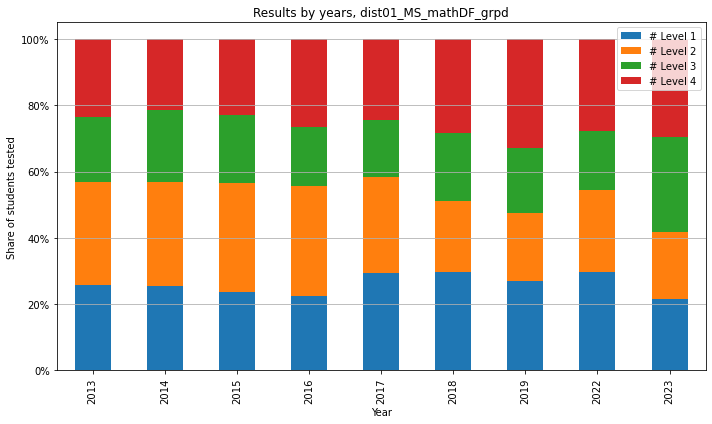

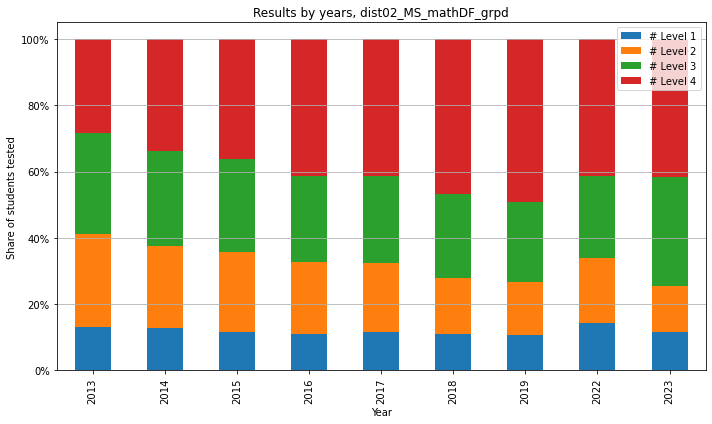

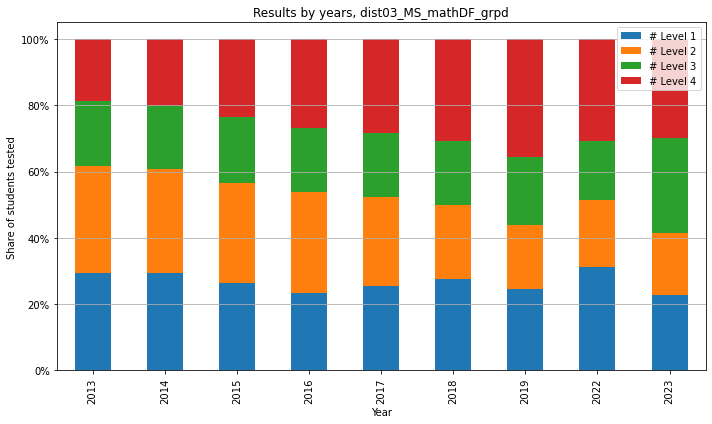

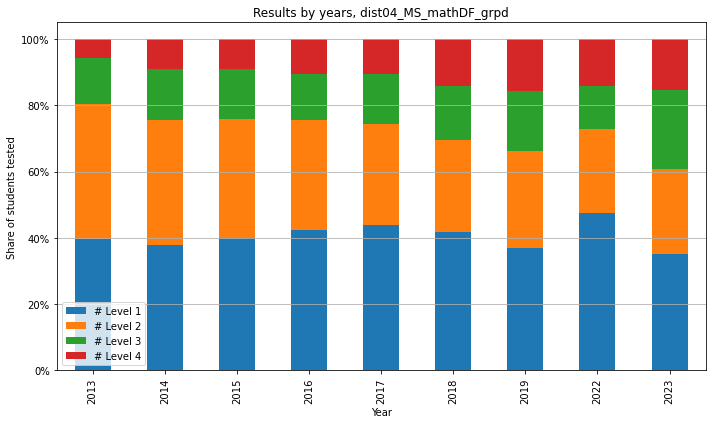

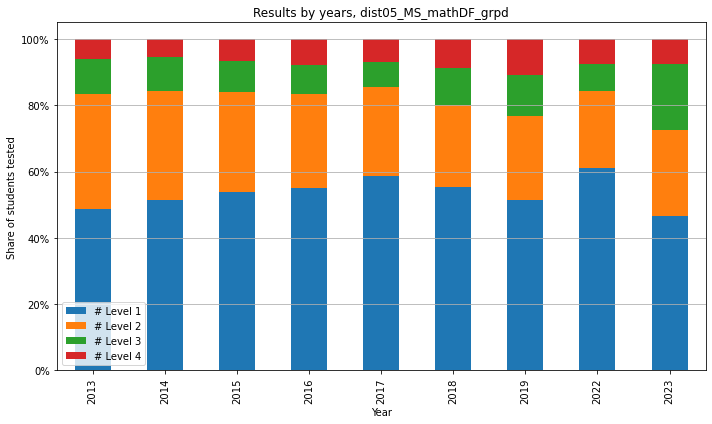

...

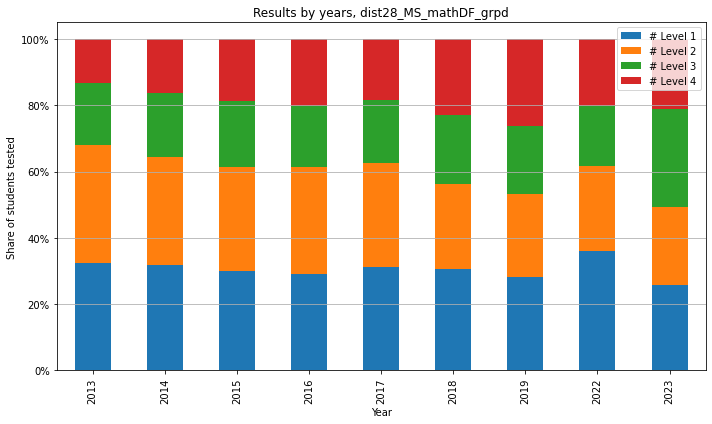

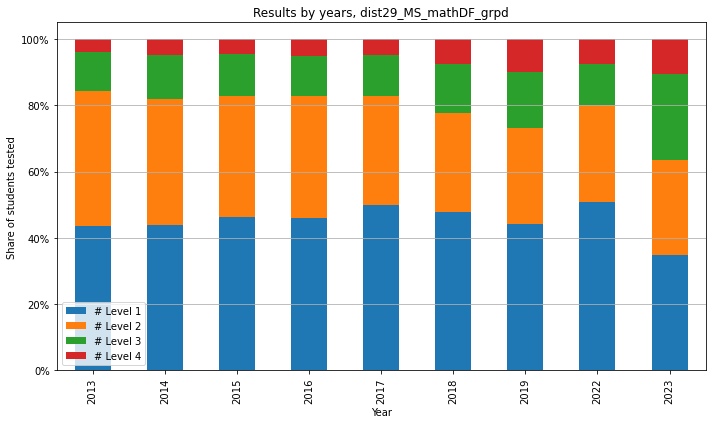

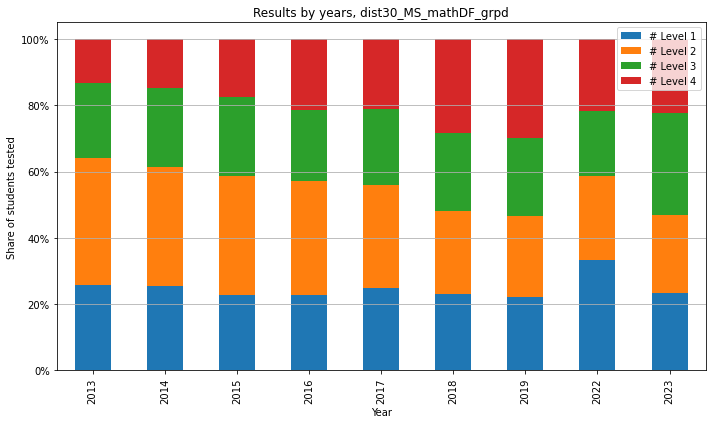

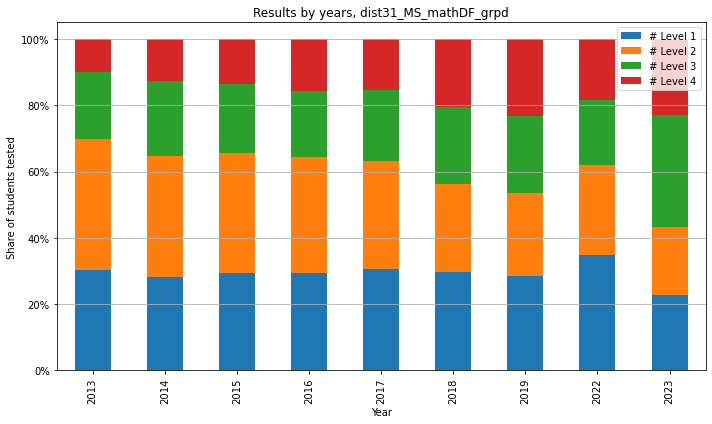

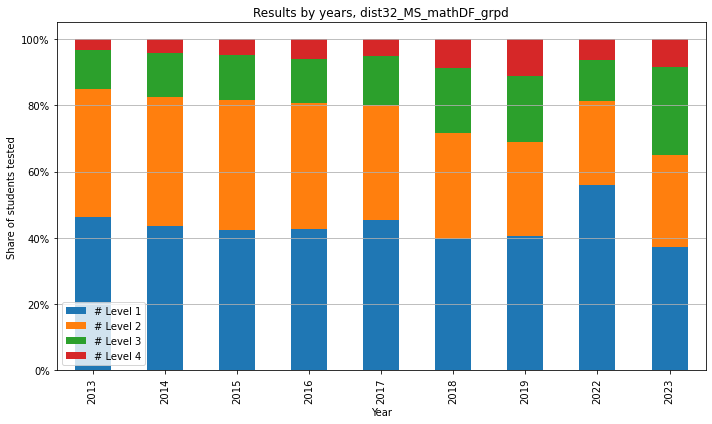

In [20]:
#Create a normalized bar chart for each dataframe in the district_dfs 
#1. Normalize the dataframe rows to sum to 1
for dfNameGrouped, current_dataframe in district_grouped_dfs.items():
    # dfNameGrouped contains the name of the dataframe
    # current_dataframe contains the dataframe itself
    # Do something with current_dataframe
    #current_dataframe.dropna()
    normalized_df = current_dataframe.div(current_dataframe.sum(axis=1), axis=0)

    # 2. Plot the normalized dataframe
    normalized_df.plot(kind='bar', stacked=True, figsize=(10,6))
    
    title = 'Results by years, ' + dfNameGrouped
    plt.title(title)  # Set the title
    plt.xlabel('Year')  # X-axis label
    plt.ylabel('Share of students tested')  # Y-axis label
    plt.grid(axis='y')
    plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0], ['0%', '20%', '40%', '60%', '80%', '100%'])  # Adjust y-ticks to percentage

    plt.tight_layout()
    pdfTitle = title + '.pdf' 
    plt.savefig(pdfTitle) # Save output as a pdf
    plt.show()

#### School districts by share of level 4 results 2013-2023 and by coefficient of variation

In [16]:
district_grouped_dfs['dist15_MS_mathDF_grpd']

,# Level 1,# Level 2,# Level 3,# Level 4
Year,,,,
2013,1234.000,1698.000,1052.000,577.000
2014,1115.000,1582.000,937.000,653.000
2015,933.000,1285.000,949.000,786.000
2016,890.000,1219.000,893.000,1057.000
2017,1017.000,1209.000,981.000,1058.000
2018,1054.000,1024.000,1062.000,1184.000
2019,1071.000,991.000,978.000,1239.000
2022,780.000,659.000,630.000,609.000
2023,604.000,611.000,908.000,770.000


### Select Best Schools in the NYC by Math Test Results

In [48]:
# Dataframe with only grades 6-8 results (middle schools and K-8) by years
mathResultsMS_bySchl = mathResultsDF[(mathResultsDF['Grade'] >= 6)&(mathResultsDF['Grade'] <= 8)].groupby(['DBN', 'School Name', 'Year'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
# Dataframe for middle schools by years with normalized values
mathResultsMS_bySchl_Norm = mathResultsMS_bySchl.div(mathResultsMS_bySchl.sum(axis=1), axis=0)

#### Select schools with the best math results for all middle school grades in 2023

In [ ]:
mathResultsMS_bySchl_sorted = mathResultsMS_bySchl_Norm.sort_values(by = ['Year', '# Level 4'], ascending=[False, False])
print(mathResultsMS_bySchl_sorted.head(50))
mathResultsMS_bySchl_sorted.head(50).to_csv('50_schools_with_highest_level4_share_math2023.csv', index = True)

#### Select schools with the best math results for all middle school grades in 2013-2023

In [52]:
# Dataframe with only grades 6-8 results (middle schools and K-8) by schools
mathResultsMS_bySchl_sumed = mathResultsDF[(mathResultsDF['Grade'] >= 6)&(mathResultsDF['Grade'] <= 8)].groupby(['DBN', 'School Name'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
# Dataframe for middle schools by years with normalized values
mathResultsMS_bySchl_sumed_Norm = mathResultsMS_bySchl_sumed.div(mathResultsMS_bySchl_sumed.sum(axis=1), axis=0)

In [53]:
mathResultsMS_bySchl_sumed_sorted = mathResultsMS_bySchl_sumed_Norm.sort_values(by = '# Level 4', ascending=False)
print(mathResultsMS_bySchl_sumed_sorted.head(50))
mathResultsMS_bySchl_sumed_sorted.head(50).to_csv('50_schools_with_highest_level4_share_math2013-2023.csv', index = True)

                                                           # Level 1  \
DBN    School Name                                                     
20K187 THE CHRISTA MCAULIFFE SCHOOL\I.S. 187                   0.025   
03M334 THE ANDERSON SCHOOL                                     0.004   
30Q300 THE 30TH AVENUE SCHOOL (G&T CITYWIDE)                   0.017   
30Q122 P.S. 122 MAMIE FAY                                      0.008   
01M539 NEW EXPLORATIONS INTO SCIENCE, TECHNOLOGY AND MATH      0.004   
30Q580 BACCALAUREATE SCHOOL FOR GLOBAL EDUCATION               0.000   
02M312 NEW YORK CITY LAB MIDDLE SCHOOL FOR COLLABORATIVE       0.035   
03M859 SPECIAL MUSIC SCHOOL                                    0.000   
02M114 EAST SIDE MIDDLE SCHOOL                                 0.017   
04M012 TAG YOUNG SCHOLARS                                      0.007   
20K686 BROOKLYN SCHOOL OF INQUIRY                              0.009   
21K098 I.S. 98 BAY ACADEMY                                     0

Below mapping is done with the __[Folium library](https://python-visualization.github.io/folium/latest/)__

In [21]:
NYCSchoolsData.head()

,OBJECTID,LEGAL_NAME,PHYSADDRLINE1,PHYSADDRLINE2,PHYSCITY,PHYSICALSTATE,PHYSZIPCD5,COUNTY_DESC,Contact_Name,CEO_TITLE,...,CEO_EMAIL,INST_TYPE_DESC,INSTSUBTYPDESC,RECORD_TYPE_DESC,COMMUNITY_TYPE_DESC,DIST_TYPE_DESC,SDL_DESC,INSTIT_ID,SED_CODE,geometry
0,1,BEIT RABBAN DAY SCHOOL,270 W 89TH ST,,NEW YORK,NY,10024,NEW YORK,STEPHANIE IVES,HEAD OF SCHOOL,...,stephanie@beitrabban.org,NON-PUBLIC SCHOOLS,JEWISH,NON PUBLIC SCHOOL (IMF),NEW YORK CITY,,NYC GEOG DIST 3,800000047363,310300229306,POINT (586400.58689 4516002.88366)
1,4,SISULU-WALKER CHARTER SCHOOL OF HARLEM,71-111 CONVENT AVE,,NEW YORK,NY,10027,NEW YORK,MICHELLE HAYNES,CHARTER SCHOOL LEADER,...,mhaynes@sisuluwalker.org,PUBLIC SCHOOLS,CHARTER SCHOOL,CHARTER SCHOOLS (IMF),NEW YORK CITY,,NYC GEOG DIST 5,800000047050,310500860804,POINT (588323.00877 4518829.52489)
2,7,OUR WORLD NEIGHBORHOOD CHARTER MS,38-27 30TH ST,,LONG ISLAND CITY,NY,11101,QUEENS,BRIAN FERGUSON,CHARTER SCHOOL LEADER,...,bferguson@owncs.org,PUBLIC SCHOOLS,SATELLITE SITE FOR CHARTER SCHOOLS,OTHER- NON IMF,NEW YORK CITY,,NYC GEOG DIST 30,800000059919,800000059919,POINT (590052.79036 4511940.91957)
3,22,GROWING UP GREEN MIDDLE CHARTER SCHOOL,34-12 10TH ST,,LONG ISLAND CITY,NY,11106,QUEENS,STEVE VIOLA,DIRECTOR OF OPERATIONS,...,viola@gugcs.org,PUBLIC SCHOOLS,SATELLITE SITE FOR CHARTER SCHOOLS,OTHER- NON IMF,NEW YORK CITY,,NYC GEOG DIST 30,800000084147,800000084147,POINT (589550.15361 4513155.61139)
4,34,NEW WORLD PREP CS SOUTH CAMPUS,465 VILLA AVE,,STATEN ISLAND,NY,10302,RICHMOND,AMANDA AINLEY,ADMINISTRATOR,...,aainley@newworldprep.org,PUBLIC SCHOOLS,SATELLITE SITE FOR CHARTER SCHOOLS,OTHER- NON IMF,NEW YORK CITY,,NYC GEOG DIST 31,800000091581,800000091581,POINT (572477.80703 4497912.22555)


In [22]:
NYCSchoolsData_uniqueTypes = NYCSchoolsData['RECORD_TYPE_DESC'].unique().tolist()
print(NYCSchoolsData_uniqueTypes)

['NON PUBLIC SCHOOL (IMF)', 'CHARTER SCHOOLS (IMF)', 'OTHER- NON IMF', 'PUBLIC SCHOOL (IMF)', 'STATE OPERATED SCHOOLS (IMF)', 'PUBLIC SCHOOL (NON-IMF)']


In [78]:
mathResultsMS_mappable = NYCSchoolsData.merge(mathResultsMS_bySchl_sumed_Norm, left_on='LEGAL_NAME', right_on='School Name')
#mathResultsMS_bySchl_sumed_Norm.head()
mathResultsMS_mappable.head()

,OBJECTID,LEGAL_NAME,PHYSADDRLINE1,PHYSADDRLINE2,PHYSCITY,PHYSICALSTATE,PHYSZIPCD5,COUNTY_DESC,Contact_Name,CEO_TITLE,...,COMMUNITY_TYPE_DESC,DIST_TYPE_DESC,SDL_DESC,INSTIT_ID,SED_CODE,geometry,# Level 1,# Level 2,# Level 3,# Level 4
0,131,YOUNG WOMEN'S LEADERSHIP SCHOOL,140 W 140TH ST,,NEW YORK,NY,10025,NEW YORK,COLLEEN MCGEEHAN,PRINCIPAL,...,NEW YORK CITY,,NYC GEOG DIST 4,800000046730,310400011610,POINT (589347.579 4519091.922),0.249,0.438,0.250,0.064
1,403,EAST BRONX ACADEMY FOR THE FUTURE,1716 SOUTHERN BLVD,,BRONX,NY,10460,BRONX,SARAH SCROGIN,PRINCIPAL,...,NEW YORK CITY,,NYC GEOG DIST 11,800000058011,321200011271,POINT (593775.438 4521264.002),0.537,0.308,0.125,0.030
2,404,NORTH BRONX SCHOOL OF EMPOWERMENT,3710 BARNES AVE,,BRONX,NY,10467,BRONX,MAGDALEN NEYRA,PRINCIPAL,...,NEW YORK CITY,,NYC GEOG DIST 11,800000059109,321100010287,POINT (595993.972 4526154.241),0.682,0.232,0.070,0.016
3,405,THEATRE ARTS PRODUCTION COMPANY SCHOOL,2225 WEBSTER AVE,,BRONX,NY,10457,BRONX,RON LINK,PRINCIPAL,...,NEW YORK CITY,,NYC GEOG DIST 10,800000059126,321000010225,POINT (592989.193 4523221.838),0.360,0.436,0.166,0.038
4,417,ACADEMY OF APPLIED MATHEMATICS AND TECHNOLOGY,345 BROOK AVE,,BRONX,NY,10454,BRONX,VINCENT GASSETTO,PRINCIPAL,...,NEW YORK CITY,,NYC GEOG DIST 7,800000059605,320700010343,POINT (591269.858 4518254.614),0.351,0.358,0.206,0.085


In [85]:
# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")

# Add dataframe with coordinates and test results to the map
## Making marker size proportional to the % of test takers with score at Level 4
def my_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        #"fillColor": colorsType[x['properties']['RECORD_TYPE_DESC']],
        "radius": (level4)*1000
    }   

## Adding the layer to the map
folium.GeoJson(
    mathResultsMS_mappable,
    marker = folium.Circle(radius=10, fill_color="orange", fill_opacity=1.0, color="orange", weight=0),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    style_function = my_style,        
    zoom_on_click = True,
).add_to(MathTestMS_map)

# Display the map
MathTestMS_map

In [59]:
mathResultsMS_mappable.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 148 entries, 0 to 147
Data columns (total 25 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   OBJECTID             148 non-null    int64   
 1   LEGAL_NAME           148 non-null    object  
 2   PHYSADDRLINE1        148 non-null    object  
 3   PHYSADDRLINE2        148 non-null    object  
 4   PHYSCITY             148 non-null    object  
 5   PHYSICALSTATE        148 non-null    object  
 6   PHYSZIPCD5           148 non-null    object  
 7   COUNTY_DESC          148 non-null    object  
 8   Contact_Name         148 non-null    object  
 9   CEO_TITLE            148 non-null    object  
 10  CEO_PHONENUM         147 non-null    object  
 11  CEO_EMAIL            148 non-null    object  
 12  INST_TYPE_DESC       148 non-null    object  
 13  INSTSUBTYPDESC       148 non-null    object  
 14  RECORD_TYPE_DESC     148 non-null    object  
 15  COMMUNITY_TYPE_

In [3]:
# Create a map object, centered at NYC
Schools_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")

# Add GeoJSON with public schools to the map
## Read GeoJSON into data frame
SchoolsFile = 'NYC_K-12_schools_public.geojson'
NYCSchoolsPath = os.path.join(basePath, SchoolsFile)
NYCSchoolsData = gpd.read_file(NYCSchoolsPath)

NYCSchoolsData_uniqueTypes = NYCSchoolsData['RECORD_TYPE_DESC'].unique().tolist()
colors = ["green", "blue"]
colorsType = dict(zip(NYCSchoolsData_uniqueTypes, colors))

## Set marker style
def my_marker_style(x): 
    record_type = x['properties'].get('RECORD_TYPE_DESC', 'Default')
    color = colorsType.get(record_type, "#FFFFFF")  # Default to white if type not found
    return {"fillColor": color}


## Adding the layer to the map
folium.GeoJson(
    NYCSchoolsData,
    marker = folium.Circle(radius=10, fill_color="orange", fill_opacity=1.0, color="orange", weight=0),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC"]),
    style_function = my_marker_style,
    zoom_on_click = True,
).add_to(Schools_map)

# Display the map
Schools_map

In [42]:
colorsType

{'PUBLIC SCHOOL (IMF)': 'green', 'PUBLIC SCHOOL (NON-IMF)': 'blue'}

In [4]:
# Reading with data from NYS: https://data.nysed.gov/downloads.php
basePath = r"D:\.shortcut-targets-by-id\1c4wCBVjOg0tiW0xxI4zE2Wjj1FnzKBJL\Kids\NY school"
fileName_mathNYS = "NYC_MATH_2022-2023_from_NYS.xlsx"
mathPathNYS = os.path.join(basePath,fileName_mathNYS)
print(mathPathNYS)

mathResultsNYSDF = pd.read_excel(mathPathNYS)

D:\.shortcut-targets-by-id\1c4wCBVjOg0tiW0xxI4zE2Wjj1FnzKBJL\Kids\NY school\NYC_MATH_2022-2023_from_NYS.xlsx


In [60]:
mathResultsNYSDF.head()
#mathResultsNYSDF['ASSESSMENT_NAME'].unique().tolist()
#NYCSchoolsData.head()

,ENTITY_NAME,YEAR,ASSESSMENT_NAME,SUBGROUP_NAME,TOTAL_COUNT,NUM_TESTED,LEVEL1_COUNT,LEVEL1_%TESTED,LEVEL2_COUNT,LEVEL2_%TESTED,LEVEL3_COUNT,LEVEL3_%TESTED,LEVEL4_COUNT,LEVEL4_%TESTED,COUNTY_NAME
0,PS 34 FRANKLIN D ROOSEVELT,2022,MATH6,All Students,27,23,13,57,5,22,4,17,1,04,NEW YORK
1,PS 34 FRANKLIN D ROOSEVELT,2022,MATH6,All Students,27,23,13,57,5,22,4,17,1,04,NEW YORK
2,PS 34 FRANKLIN D ROOSEVELT,2022,MATH6,All Students,27,23,13,57,5,22,4,17,1,04,NEW YORK
3,PS 34 FRANKLIN D ROOSEVELT,2022,MATH7,All Students,45,42,35,83,5,12,2,05,0,00,NEW YORK
4,PS 34 FRANKLIN D ROOSEVELT,2022,MATH7,All Students,45,42,35,83,5,12,2,05,0,00,NEW YORK


In [5]:
mathResultsMS_mappable_2223 = NYCSchoolsData.merge(mathResultsNYSDF, left_on='LEGAL_NAME', right_on='ENTITY_NAME')
mathResultsMS_mappable_2223.head()
mathResultsMS_mappable_2223.info()

#mathResultsMS_mappable_2223.to_file("mathResultsMS2223.geojson", driver='GeoJSON')

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 5092 entries, 0 to 5091
Data columns (total 36 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   OBJECTID             5092 non-null   int64   
 1   LEGAL_NAME           5092 non-null   object  
 2   PHYSADDRLINE1        5092 non-null   object  
 3   PHYSADDRLINE2        5092 non-null   object  
 4   PHYSCITY             5092 non-null   object  
 5   PHYSICALSTATE        5092 non-null   object  
 6   PHYSZIPCD5           5092 non-null   object  
 7   COUNTY_DESC          5092 non-null   object  
 8   Contact_Name         5092 non-null   object  
 9   CEO_TITLE            5092 non-null   object  
 10  CEO_PHONENUM         5071 non-null   object  
 11  CEO_EMAIL            5092 non-null   object  
 12  INST_TYPE_DESC       5092 non-null   object  
 13  INSTSUBTYPDESC       5092 non-null   object  
 14  RECORD_TYPE_DESC     5092 non-null   object  
 15  COMMUNITY_TYP

In [13]:
# mathResultsMS_mappable_2223.info() showed that most of the columns are objects instead of numbers and needed to be converted
colToConvert = [                            
 'LEVEL1_COUNT',
 'LEVEL1_%TESTED',
 'LEVEL2_COUNT',
 'LEVEL2_%TESTED',
 'LEVEL3_COUNT',
 'LEVEL3_%TESTED',
 'LEVEL4_COUNT',
 'LEVEL4_%TESTED',
 ]
mathResultsMS_mappable_2223[colToConvert] = mathResultsMS_mappable_2223[colToConvert].apply(pd.to_numeric, errors = 'coerce')
mathResultsMS_mappable_2223.info()
mathResultsMS_mappable_2223.to_file("mathResultsMS2223.geojson", driver='GeoJSON')

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 5092 entries, 0 to 5091
Data columns (total 36 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   OBJECTID             5092 non-null   int64   
 1   LEGAL_NAME           5092 non-null   object  
 2   PHYSADDRLINE1        5092 non-null   object  
 3   PHYSADDRLINE2        5092 non-null   object  
 4   PHYSCITY             5092 non-null   object  
 5   PHYSICALSTATE        5092 non-null   object  
 6   PHYSZIPCD5           5092 non-null   object  
 7   COUNTY_DESC          5092 non-null   object  
 8   Contact_Name         5092 non-null   object  
 9   CEO_TITLE            5092 non-null   object  
 10  CEO_PHONENUM         5071 non-null   object  
 11  CEO_EMAIL            5092 non-null   object  
 12  INST_TYPE_DESC       5092 non-null   object  
 13  INSTSUBTYPDESC       5092 non-null   object  
 14  RECORD_TYPE_DESC     5092 non-null   object  
 15  COMMUNITY_TYP

In [7]:
string1 = mathResultsMS_mappable_2223['ENTITY_NAME'].iloc[0]  # First cell in 'column1'
string2 = mathResultsMS_mappable_2223['LEGAL_NAME'].iloc[0]  # First cell in 'column2'

differences = []
# Check for exact match
for i in differences:
        if string1 == string2:
            i = i+1
print("there are: "+str(len(differences))+" differences")
    
    

there are: 0 differences


In [12]:
# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")

# Add dataframe with coordinates and test results to the map
## Making marker size proportional to the % of test takers with score at Level 4
def my_style(x):
    level4 = x['properties']['LEVEL4_%TESTED']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        #"fillColor": colorsType[x['properties']['RECORD_TYPE_DESC']],
        "radius": (level4)*10
    }   

## Adding the layer to the map
folium.GeoJson(
    mathResultsMS_mappable_2223,
    marker = folium.Circle(radius=10, fill_color="orange", fill_opacity=1.0, color="yellow", weight=1),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME", "ENTITY_NAME", "RECORD_TYPE_DESC", "LEVEL4_%TESTED"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME", "ENTITY_NAME", "RECORD_TYPE_DESC", "LEVEL4_%TESTED"]),
    style_function = my_style,        
    zoom_on_click = True,
).add_to(MathTestMS_map)

# Display the map
MathTestMS_map

In [94]:
m = folium.Map([40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")

folium.GeoJson(
    mathResultsMS_mappable_2223,
    marker=folium.Circle(radius=40, fill_color="orange", fill_opacity=0.4, color="black", weight=1),
).add_to(m)

m

In [ ]:
# Match the schools names in the 2 dataframes: NYCSchoolsDataShort (geometry) and mathResultsMS_bySchl_Norm (test results)

def find_match_and_assign_id(row, target_column, threshold=0.8):
    # Find the best match in the target column
    best_match = difflib.get_close_matches(row, target_column, n=1, cutoff=threshold)
    # If there is a sufficiently similar string
    if best_match:
        # Return a tuple of the original string and its best match
        return (row, best_match[0])
    return (row, None)

# Apply the function to each element in NYCSchoolsDataShort['LEGAL_NAME']
matches = NYCSchoolsDataShort['LEGAL_NAME'].apply(lambda x: find_match_and_assign_id(x, mathResultsMS_bySchl_Norm['School Name'].tolist()))

# Create a dictionary to store IDs
match_ids = {}
current_id = 1

for original, match in matches:
    if match:
        if match not in match_ids:
            match_ids[match] = current_id
            current_id += 1
        # Assign the ID to the original string
        match_ids[original] = match_ids[match]

# Add a new column for the IDs
NYCSchoolsDataShort['matchID'] = NYCSchoolsDataShort['LEGAL_NAME'].map(match_ids)
mathResultsMS_bySchl_Norm['matchID'] = mathResultsMS_bySchl_Norm['School Name'].map(match_ids)

In [ ]:
mathResultsMS_bySchl_Norm.head()
mathResultsMS_bySchl_Norm.info()

In [ ]:
mathResultsMS_bySchl_Norm['matchID'] = mathResultsMS_bySchl_Norm['matchID'].astype(int)
NYCSchoolsDataShort['matchID'] = NYCSchoolsDataShort['matchID'].astype(int)

In [ ]:
mathResultsMS_bySchl_Norm['matchID'].isnull().sum(), NYCSchoolsDataShort['matchID'].isnull().sum()

In [ ]:
mathResultsMS_bySchl_Norm.to_excel("mathResultsMS_bySchl_Norm.xlsx")
NYCSchoolsDataShort.to_excel("NYCSchoolsDataShort.xlsx")

In [ ]:
# Make a dataframe with history test results for top 50 schools 2023
MathTop50History_mappable = NYCpublicSchoolsMath_mappable[NYCpublicSchoolsMath_mappable['LEGAL_NAME'].isin(MathTop50Data['LEGAL_NAME'])]
MathTop50History_mappable.head(20)

In [ ]:
    
    MathTop50File = "NYCpublicSchoolsMathTop50.geojson"
    MathTop50Path = os.path.join(basePath, MathTop50File)
    MathTop50Data = gpd.read_file(MathTop50Path)
    MathTop50Data.head(50)

In [ ]:
def create_plot():
    dataframe.plot(kind='bar', stacked=True, figsize=(10,6))
    title = 'Results by years, ' + name
    plt.title(title)  # Set the title
    plt.xlabel('Year')  # X-axis label
    plt.ylabel('Share of students tested')  # Y-axis label
    plt.grid(axis='y')
    plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0], ['0%', '20%', '40%', '60%', '80%', '100%'])  # Adjust y-ticks to percentage
    plt.tight_layout()
    # Return the figure object for further use
    return plt.gcf()  # gcf - Get Current Figure

In [ ]:
name = 'ANDERSON SCHOOL (THE)'
MathTop50History_mappable[MathTop50History_mappable['LEGAL_NAME'] == name]

In [ ]:
# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")

# Add dataframe with coordinates and test results to the map
## Making marker size proportional to the % of test takers with score at Level 4
def my_style(x):
    level4 = x['properties']['LEVEL4_%TESTED']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        #"fillColor": colorsType[x['properties']['RECORD_TYPE_DESC']],
        "radius": (level4)*10
    }   

## Adding the layer to the map
folium.GeoJson(
    mathResultsMS_mappable_2223,
    marker = folium.Circle(radius=10, fill_color="orange", fill_opacity=1.0, color="yellow", weight=1),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME", "ENTITY_NAME", "RECORD_TYPE_DESC", "LEVEL4_%TESTED"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME", "ENTITY_NAME", "RECORD_TYPE_DESC", "LEVEL4_%TESTED"]),
    style_function = my_style,        
    zoom_on_click = True,
).add_to(MathTestMS_map)

# Display the map
MathTestMS_map